# Reproducing experimental results

## 0. General settings

In [1]:
#----------------
# import modules
#----------------
import os
from utils.util import load_dataset
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.animation as animation
import numpy as np

In [2]:
#---------------------
# user-defined params 
#---------------------
GPU              = 0
VEHICLE_SPEED    = 41.0 # km/h
WAIT_TIME        = 0.5  # h
TRAIN_BATCH_SIZE = 256
EVAL_BATCH_SIZE  = 256
MAX_BATCH_SIZE   = 12800
EVAL_SIZE        = 100
TRAIN_EPOCH      = 100
TRAIN_SAMPLE     = 1280000
VALID_SAMPLE     = 1000
EVAL_SAMPLE      = 100
RL_BASELINE      = "rollout"
RANDOM_SEED      = 1234
TRAIN_PATTERNS   = [
    {
        "name": "ev12_n50_t12",
        "num_evs": 12,
        "num_locs": 50,
        "time_horizon": 12,
        "dropout": 0.2
    },
    {
        "name": "ev12_n25_t12",
        "num_evs": 12,
        "num_locs": 25,
        "time_horizon": 12,
        "dropout": 0.2
    },
    {
        "name": "ev6_n50_t12",
        "num_evs": 6,
        "num_locs": 50,
        "time_horizon": 12,
        "dropout": 0.2
    },
]
#-------------------------
# end user-defined params
#-------------------------


#---------------------------------------------
# the following params are automatically set,
# so DO NOT tatch them
#---------------------------------------------

#-----------
# file name
#-----------
DATASET_DIR     = "data/syn_ev{num_evs}_n{num_locs}"
CHECKPOINT_DIR  = "checkpoints/weight100_ev{num_evs}_n{num_locs}_t{time_horizon}_drop{dropout}"
OUTPUT_DIR      = "results/{dataset_name}_T{time_horizon}_evaluation/{model_name}"

#------------
# model list
#------------
model_list = []
for train_params in TRAIN_PATTERNS:
    num_evs  = train_params["num_evs"]
    num_locs = train_params["num_locs"]
    time_horizon = train_params["time_horizon"]
    dropout = train_params["dropout"]
    model = {
        "dataset_dir": DATASET_DIR.format(num_evs=num_evs, num_locs=num_locs),
        "checkpoint_dir": CHECKPOINT_DIR.format(num_evs=num_evs, num_locs=num_locs, time_horizon=time_horizon, dropout=dropout),
        "train_params": train_params
    }
    model_list.append(model)

## 1. Generating synthetic datasets
It takes around 10 minutes to generate a dataset.

In [ ]:
generated_dataset_list = []
for model in model_list:
    dataset_dir = model["dataset_dir"]
    if dataset_dir not in generated_dataset_list: # avoid duplicating the same dataset
        num_evs  = train_params["num_evs"]
        num_locs = train_params["num_locs"]
        !python generate_dataset.py --save_dir {dataset_dir} \
                                    --num_samples {TRAIN_SAMPLE} {VALID_SAMPLE} {EVAL_SAMPLE} \
                                    --num_vehicles {num_evs} \
                                    --num_locs {num_locs} \
                                    --random_seed {RANDOM_SEED}
    generated_dataset_list.append(dataset_dir)

## 2. Training models
A single RTX A6000 takes about 10 days to train a model for 100 epochs.  
Therefore, we recommend training models in parallel via the terminal, not this notebook.

In [ ]:
for model in model_list:
    dataset_path    = model["dataset_dir"] + "/train_dataset.pkl"
    checkpoint_dir  = model["checkpoint_dir"]
    num_evs         = model["train_params"]["num_evs"]
    num_locs        = model["train_params"]["num_locs"]
    time_horizon    = model["train_params"]["time_horizon"]
    dropoout        = model["train_params"]["dropout"]
    # train
    !python train.py --dataset_path {dataset_path} \
                     --model_checkpoint_path {checkpoint_dir} \
                     --time_horizon {time_horizon} \
                     --batch_size {TRAIN_BATCH_SIZE} \
                     --baseline {RL_BASELINE} \
                     --vehicle_speed {VEHICLE_SPEED} \
                     --wait_time {WAIT_TIME} \
                     --epoch {TRAIN_EPOCH} \
                     --dropout {dropout} \
                     --gpu {GPU}

selected device: GPU #0


## 3. Hold-out Validation (Model selection)

In [6]:
for model in model_list:
    dataset_path = model["dataset_dir"] + "/valid_dataset.pkl"
    model_dir    = model["checkpoint_dir"]
    time_horizon = model["train_params"]["time_horizon"]
    # validate
    !python valid.py --model_dir {model_dir} \
                     --dataset_path {dataset_path} \
                     --eval_batch_size {EVAL_BATCH_SIZE} \
                     --vehicle_speed {VEHICLE_SPEED} \
                     --wait_time {WAIT_TIME} \
                     --time_horizon {time_horizon} \
                     --max_epoch {TRAIN_EPOCH} \
                     --gpu {GPU}

Evaluating the model at epoch0 (currently best epoch is 0: cost=1000000000.0)
selected device: GPU #0
100%|█████████████████████████████████████████████| 4/4 [00:07<00:00,  1.80s/it]
Evaluating the model at epoch1 (currently best epoch is 0: cost=28.45809555053711)
selected device: GPU #0
100%|█████████████████████████████████████████████| 4/4 [00:05<00:00,  1.43s/it]
Evaluating the model at epoch2 (currently best epoch is 1: cost=22.931411743164062)
selected device: GPU #0
100%|█████████████████████████████████████████████| 4/4 [00:04<00:00,  1.07s/it]
Evaluating the model at epoch3 (currently best epoch is 2: cost=20.801347732543945)
selected device: GPU #0
100%|█████████████████████████████████████████████| 4/4 [00:04<00:00,  1.22s/it]
Evaluating the model at epoch4 (currently best epoch is 3: cost=18.33037567138672)
selected device: GPU #0
100%|█████████████████████████████████████████████| 4/4 [00:05<00:00,  1.29s/it]
Evaluating the model at epoch5 (currently best epoch is 4: cost

## 4. Quantitative evaluation

### 4.0. General Settings

In [3]:
competiter_list = [
    {
        "name": "wo_move",
        "model_type": "wo_move",
        "decode_type": None,
        "search_width": 1,
    },
    {
        "name": "greedy",
        "model_type": "naive_greedy",
        "decode_type": None,
        "search_width": 1,
    },
    {
        "name": "random",
        "model_type": "naive_random",
        "decode_type": None,
        "search_width": 12800,
    },
    {
        "name": "rlgreedy",
        "model_type": "rl",
        "decode_type": "greedy",
        "search_width": 1,
    },
    {
        "name": "rlsample1280",
        "model_type": "rl",
        "decode_type": "sampling",
        "search_width": 1280,
    },
    {
        "name": "rlsample12800",
        "model_type": "rl",
        "decode_type": "sampling",
        "search_width": 12800,
    },
]

In [4]:
import pandas as pd
import json
from typing import List, Dict, Any
from eval import eval

#---------------------
# evaluate all models
#---------------------
def eval_all(competiter_list: List[Dict[str, Any]],
             dataset_list: List[Dict[str, str]],
             timehorizon_list: List[int],
             visualize_routes: bool = False) -> None:
    for dataset_name, dataset_path, model_dir in dataset_list:
        for time_horizon in timehorizon_list:
            print(f"{dataset_name} T={time_horizon}")
            for competiter in competiter_list:
                print(competiter["model_type"], competiter["decode_type"], competiter["search_width"])
                output_dir = OUTPUT_DIR.format(dataset_name=dataset_name, time_horizon=time_horizon, model_name=competiter["name"])
                # evaluate
                eval(time_horizon=time_horizon,
                     model_type=competiter["model_type"],
                     decode_type=competiter["decode_type"],
                     search_width=competiter["search_width"],
                     dataset_path=dataset_path,
                     model_dir=model_dir,
                     output_dir=output_dir,
                     gpu=GPU,
                     vehicle_speed=VEHICLE_SPEED,
                     wait_time=WAIT_TIME,
                     max_batch_size=MAX_BATCH_SIZE,
                     eval_batch_size=EVAL_BATCH_SIZE,
                     max_load_size=EVAL_SIZE,
                     visualize_routes=visualize_routes)

#----------------------------------
# summarize the evaluation results
#----------------------------------
def summarize_results(competiter_list: List[Dict[str, Any]],
                      dataset_list: List[Dict[str, str]],
                      timehorizon_list: List[int]) -> pd.DataFrame:
    idx = []; col1 = []; col2 = []; results = [[] for _ in range(len(competiter_list))]
    for i, competiter in enumerate(competiter_list):
        model_name = competiter["name"]
        idx.append(model_name)
        for dataset_name, dataset_path, model_dir in dataset_list:
            for time_horizon in timehorizon_list:
                if i == 0:
                    for eval_values in ["len.", "down", "obj", "time"]:
                        col1.append(f"{dataset_name}_T{time_horizon}")
                        col2.append(eval_values)
                # read a log file
                log_fname = OUTPUT_DIR.format(dataset_name=dataset_name, time_horizon=time_horizon, model_name=model_name) + "/summary.json"
                with open(log_fname, "r") as f:
                    res = json.load(f)
                    results[i].append(round(float(res["avg_actual_tour_length"]))) # (actual) route length
                    results[i].append(round(float(res["avg_num_down"]), 2))        # num down locs
                    results[i].append(round(float(res["avg_obj"]), 2))             # objevtive value
                    results[i].append(round(float(res["total_calc_time"]), 2))     # total calc time
    col = pd.MultiIndex.from_arrays([col1, col2])
    return pd.DataFrame(results, index=idx, columns=col)

### 4.1. Evaluation on synthetic datasets

In [5]:
syn_dataset_list = [
    ("SYN-EV6", "data/syn_ev6_n50/eval_dataset.pkl",   "checkpoints/weight100_ev6_n50_t12_drop0.2"),
    ("SYN-EV12", "data/syn_ev12_n50/eval_dataset.pkl", "checkpoints/weight100_ev12_n50_t12_drop0.2")
]
timehorizon_list = [12, 24]

In [6]:
eval_all(competiter_list, syn_dataset_list, timehorizon_list, vis)

SYN-EV6 T=12
wo_move None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.42s/it]


naive_greedy None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.25it/s]


naive_random None 12800
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [01:09<00:00, 69.68s/it]


rl greedy 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.42it/s]


rl sampling 1280
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:51<00:00, 51.14s/it]


rl sampling 12800
selected device: GPU #0


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [08:32<00:00, 512.61s/it]


SYN-EV6 T=24
wo_move None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.24s/it]


naive_greedy None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.32s/it]


naive_random None 12800
selected device: GPU #0


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [02:06<00:00, 126.19s/it]


rl greedy 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.06s/it]


rl sampling 1280
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [01:28<00:00, 88.04s/it]


rl sampling 12800
selected device: GPU #0


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [14:38<00:00, 878.42s/it]


SYN-EV12 T=12
wo_move None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.34s/it]


naive_greedy None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.21s/it]


naive_random None 12800
selected device: GPU #0


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [02:58<00:00, 178.16s/it]


rl greedy 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:01<00:00,  1.14s/it]


rl sampling 1280
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [01:27<00:00, 87.99s/it]


rl sampling 12800
selected device: GPU #0


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [14:38<00:00, 878.57s/it]


SYN-EV12 T=24
wo_move None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.29s/it]


naive_greedy None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.54s/it]


naive_random None 12800
selected device: GPU #0


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [05:31<00:00, 331.98s/it]


rl greedy 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:02<00:00,  2.03s/it]


rl sampling 1280
selected device: GPU #0


100%|████████████████████████████████████████████████████████████████████████████████████| 1/1 [02:45<00:00, 165.70s/it]


rl sampling 12800
selected device: GPU #0


100%|███████████████████████████████████████████████████████████████████████████████████| 1/1 [27:38<00:00, 1658.08s/it]


In [7]:
summarize_results(competiter_list, syn_dataset_list, timehorizon_list)

SYN-EV6_T12                       SYN-EV6_T24                \
                     len.   down    obj    time        len.   down    obj   
wo_move                 0  20.08  40.15    2.29           0  33.27  66.55   
greedy                189  17.67  37.23    0.60         312  29.83  62.78   
random                142  15.30  32.01   69.45         263  26.45  55.53   
rlgreedy               81  12.53  25.86    0.52         125  25.24  51.73   
rlsample1280           78  12.37  25.52   50.91         125  24.58  50.41   
rlsample12800          78  12.35  25.47  512.40         126  24.45  50.17   

                      SYN-EV12_T12                       SYN-EV12_T24         \
                 time         len.   down    obj    time         len.   down   
wo_move          1.07            0  20.06  40.13    1.15            0  33.31   
greedy           1.12          192  15.50  32.93    1.02          317  26.64   
random         125.98          157  11.75  25.07  177.95          283  21.12   
rlgreedy         0.89           78   6.63  14.03    0.97          131  18.24   
rlsample1280    87.81           75   6.41  13.57   87.76          129  17.35   
rlsample12800  878.18           74   6.38  13.51  878.35          129  17.20   

                               
                 obj     time  
wo_move        66.62     2.11  
greedy         56.44     2.36  
random         45.07   331.77  
rlgreedy       37.78     1.84  
rlsample1280   35.99   165.48  
rlsample12800  35.69  1657.82

### 4.2. Evaluation on real datasets (only private)
As we use our private dataset, you cannot conduct the experiments below.  
Please see the results just for reference purposes.

In [17]:
real_dataset_list = [
    ("REAL-EV6",  "data/real_datasets/real_ev6.pkl",   "checkpoints/weight100_ev6_n50_t12_drop0.2"),
    ("REAL-EV12",  "data/real_datasets/real_ev12.pkl",   "checkpoints/weight100_ev12_n50_t12_drop0.2"),
]
timehorizon_list = [12, 24]

REAL-EV6 T=12
wo_move None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.97s/it]


naive_greedy None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:03<00:00,  3.76s/it]


naive_random None 12800
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:04<00:00,  4.58s/it]


rl greedy 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:04<00:00,  4.94s/it]


rl sampling 1280
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:04<00:00,  4.83s/it]


rl sampling 12800
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:12<00:00, 12.28s/it]


REAL-EV6 T=24
wo_move None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:06<00:00,  6.60s/it]


naive_greedy None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:05<00:00,  5.96s/it]


naive_random None 12800
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:10<00:00, 10.68s/it]


rl greedy 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:09<00:00,  9.22s/it]


rl sampling 1280
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:10<00:00, 10.77s/it]


rl sampling 12800
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:23<00:00, 23.77s/it]


REAL-EV12 T=12
wo_move None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:04<00:00,  4.84s/it]


naive_greedy None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:07<00:00,  7.72s/it]


naive_random None 12800
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:11<00:00, 11.06s/it]


rl greedy 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:06<00:00,  6.87s/it]


rl sampling 1280
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:10<00:00, 10.18s/it]


rl sampling 12800
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:33<00:00, 33.95s/it]


REAL-EV12 T=24
wo_move None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:10<00:00, 10.54s/it]


naive_greedy None 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:11<00:00, 11.06s/it]


naive_random None 12800
selected device: GPU #0


  0%|                                                                                             | 0/1 [00:00<?, ?it/s]/workspace/app/projects/github/evrp-eps/models/state.py:960: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(10, 30))
100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:27<00:00, 27.35s/it]


rl greedy 1
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:19<00:00, 19.68s/it]


rl sampling 1280
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:24<00:00, 24.60s/it]


rl sampling 12800
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [01:04<00:00, 64.90s/it]


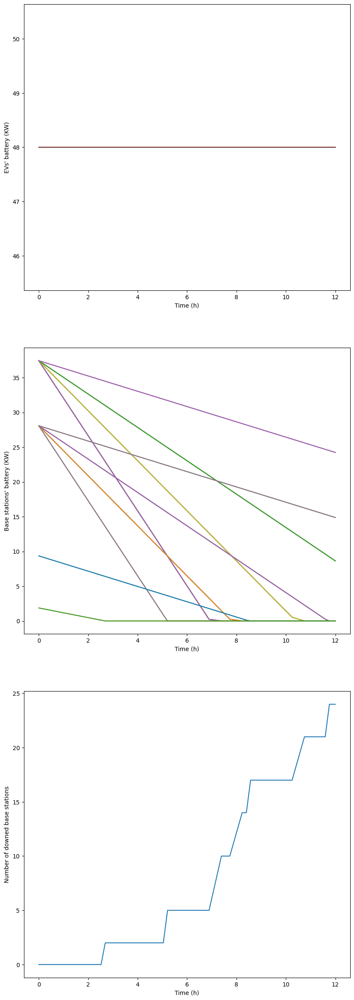

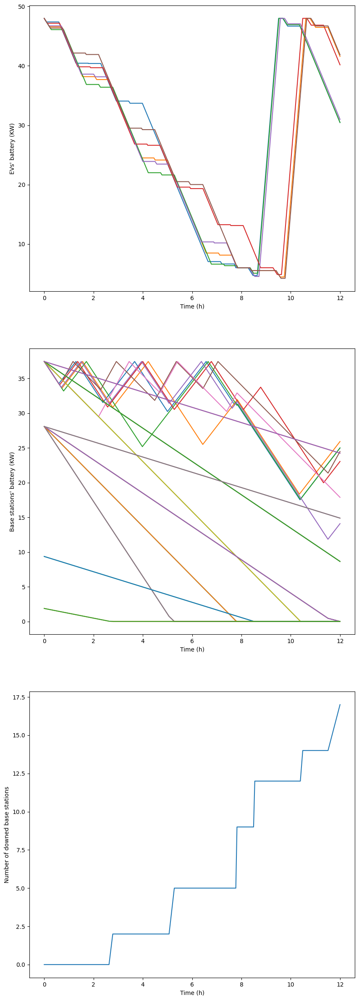

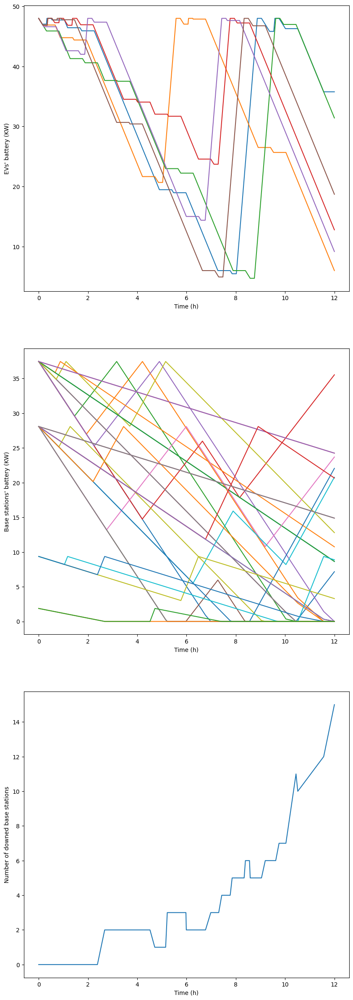

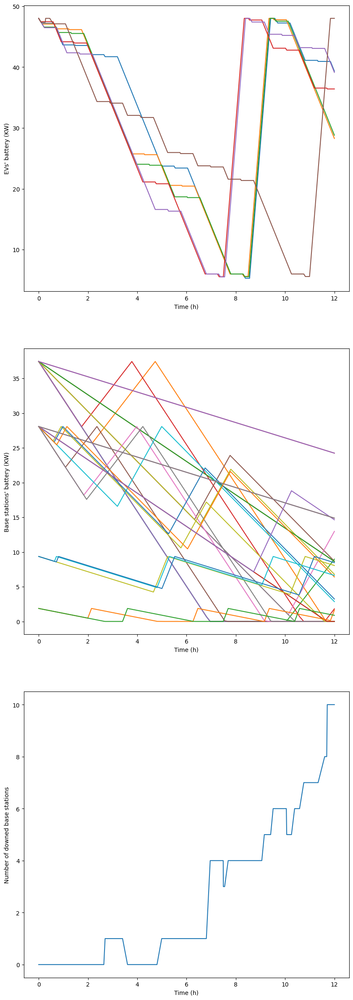

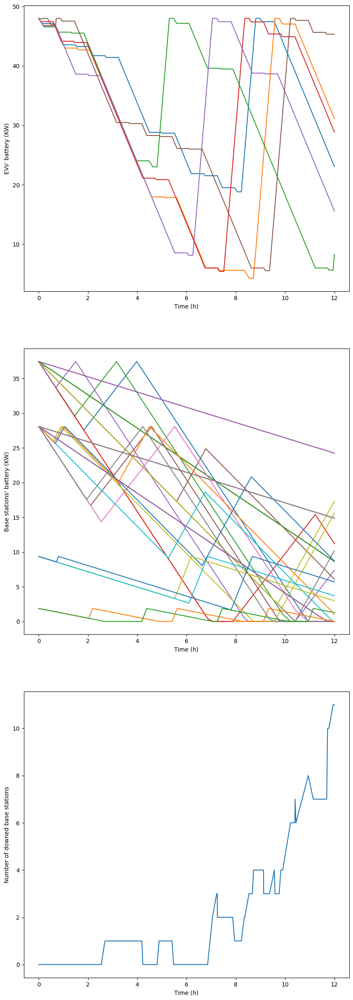

...

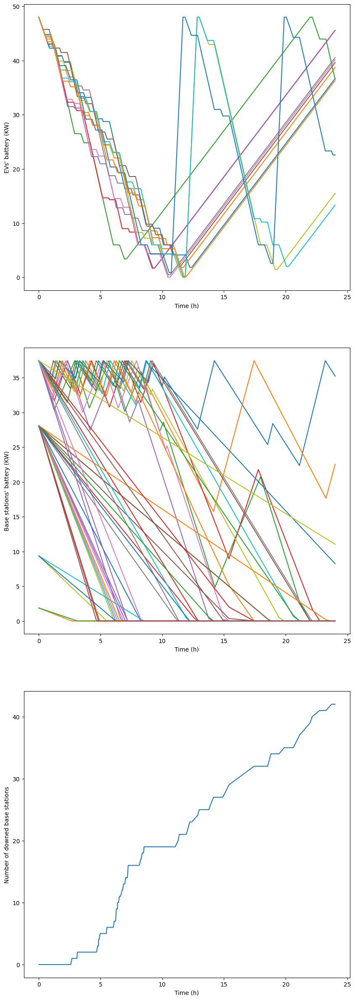

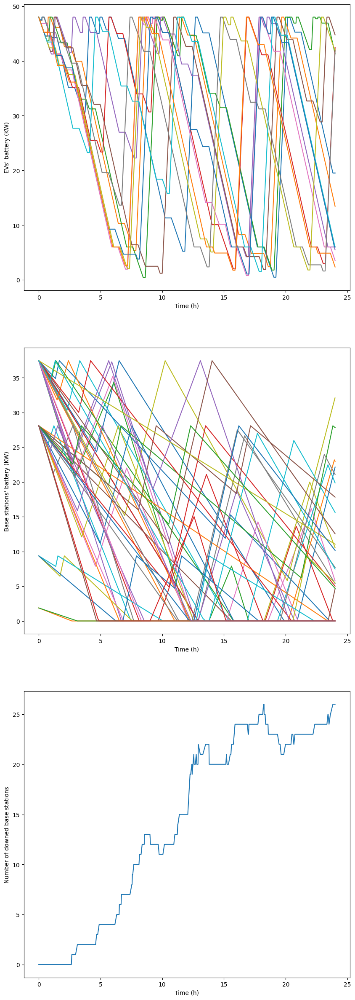

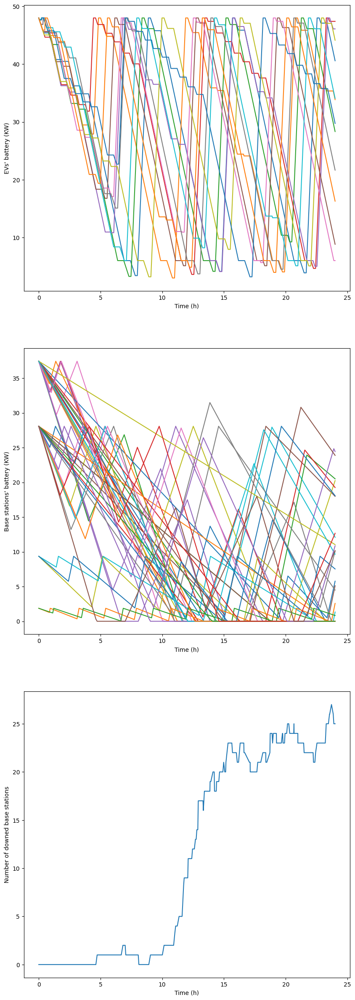

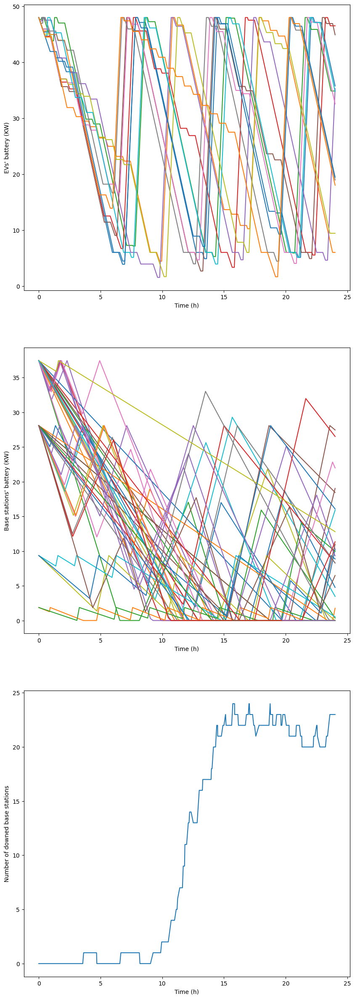

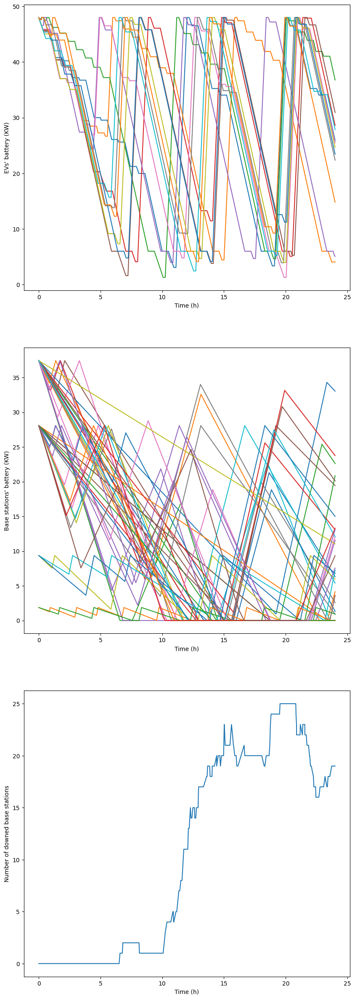

In [26]:
eval_all(competiter_list, real_dataset_list, timehorizon_list, visualize_routes=True)

In [7]:
!pip install scikit-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 77.1 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.2/302.2 kB 95.6 MB/s eta 0:00:00


In [19]:
#-----------------
# evaluate CP4TSN
#-----------------
dt_list = [
    ("tsn1",  1.0, None, None),
    ("tsn05", 0.5, None, None)
]
for dataset_name, dataset_path, _ in real_dataset_list:
    for time_horizon in timehorizon_list:
        print(f"{dataset_name} T={time_horizon}")
        for model_name, dt, _, __ in dt_list:
            print(model_name)
            output_dir = f"results/{dataset_name}_T{time_horizon}_evaluation/{model_name}"
            log_fname  = f"{output_dir}/summary.json"
            !python eval_cp4tsn.py --dataset_path {dataset_path} \
                                   --clustering \
                                   --cluster_type kmeans \
                                   --merge_duplicated_depots \
                                   --time_horizon {time_horizon} \
                                   --parallel \
                                   --num_cpus 12 \
                                   --limit_type time \
                                   --time_limit  1800 \
                                   --dt {dt} \
                                   --log_fname {log_fname}

REAL-EV6 T=12
tsn1
  0%|                                                     | 0/1 [00:00<?, ?it/s]The original problem was split into 6 sub-problem(s)!
defining a model...done
defining a model...done
defining a model...done
defining a model...done
defining a model...done
defining a model...done
The optimal solution found!!!
The optimal solution found!!!
The optimal solution found!!!
The optimal solution found!!!
The optimal solution found!!!
The optimal solution found!!!
100%|█████████████████████████████████████████████| 1/1 [01:26<00:00, 86.10s/it]
tsn05
  0%|                                                     | 0/1 [00:00<?, ?it/s]The original problem was split into 6 sub-problem(s)!
defining a model...done
defining a model...done
defining a model...done
defining a model...done
defining a model...done
defining a model...done
The optimal solution found!!!
The optimal solution found!!!
The optimal solution found!!!
The optimal solution found!!!
The optimal solution found!!!
The opti

In [20]:
tsn_list = [
    {
        "name": "tsn1",
        "model_type": 1.0,
        "decode_type": None,
        "search_width": None,
    },
    {
        "name": "tsn05",
        "model_type": 0.5,
        "decode_type": None,
        "search_width": None,
    },
]

all_competiter_list = competiter_list + tsn_list

In [27]:
summarize_results(all_competiter_list, real_dataset_list, timehorizon_list)

REAL-EV6_T12                      REAL-EV6_T24                \
                      len.  down    obj    time         len.   down    obj   
wo_move                  0  8.25  24.99    0.74            0  17.52  53.10   
greedy                  30  5.87  19.41    0.23           37  13.47  42.82   
random                  32  3.74  13.10    1.37           63  10.03  33.83   
rlgreedy                17  2.53   8.61    0.38           26   8.46  27.05   
rlsample1280            21  2.03   7.27    1.36           35   8.37  27.28   
rlsample12800           19  1.96   6.97    8.76           33   8.15  26.47   
tsn1                    16  5.62  17.87   85.77           24  12.56  39.37   
tsn05                   16  3.40  11.19  688.72           31  11.55  36.71   

                       REAL-EV12_T12                      REAL-EV12_T24  \
                  time          len.   down    obj   time          len.   
wo_move           1.37             0  11.26  24.48   1.08             0   
greedy            0.31            88   9.34  21.74   0.45           107   
random            2.25           120   4.98  12.75   4.78           215   
rlgreedy          0.51            59   1.06   3.26   0.45            99   
rlsample1280      2.32            61   0.65   2.41   3.83           101   
rlsample12800    15.16            61   0.48   2.03  27.81           100   
tsn1           1801.83            47   4.54  10.62  21.95            98   
tsn05          1802.89            53   3.32   8.06  88.45           105   

                                      
                down    obj     time  
wo_move        25.92  56.35     2.71  
greedy         20.88  47.12     0.51  
random         14.24  34.42     8.29  
rlgreedy       11.07  25.64     0.80  
rlsample1280   10.84  25.20     6.36  
rlsample12800  10.60  24.66    46.99  
tsn1           14.20  32.44  1801.25  
tsn05          14.98  34.25  1802.34

## 5. Visualization of routes

In [28]:
def get_color(id):
    cmap = plt.get_cmap("tab10")
    additional_colors = ["gold", "chartreuse"]
    if id <= 9:
        color = cmap(id)
    else:
        color = additional_colors[id - 10]
    return color

class BSColor():
    def __init__(self):
        self.idx_list = [0, 0, 0, 0]
    
    def get_color(self, init_batt):
        reds    = ["red", "salmon", "brown", "orangered"]
        greens  = ["gold", "orange", "goldenrod", "darkkhaki"]
        blues   = ["forestgreen", "limegreen", "darkgreen", "green", "lime", "seagreen", "mediumseagreen", "springgreen", 
                   "mediumspringgreen", "mediumaquamarine", "aquamarine", "turquoise", "lightseagreen", "mediumturquoise", "palegreen",
                   "lightgreen", "yellowgreen", "darkolivegreen", "greenyellow", "chartreuse", "lawngreen", "olive", "darkseagreen"]
        purples = ["purple", "midnightblue", "navy", "darkblue", "mediumblue", "blue", "slateblue", "darkslateblue", "mediumslateblue", "mediumpurple",
                   "steelblue", "cornflowerblue", "royalblue", "rebeccapurple", "blueviolet", "indigo", "darkorchid", "darkviolet", "mediumorchid", "plum", "violet", "darkmagenta"]
        
        if init_batt < 5.0:
            color = reds[self.idx_list[0]] if self.idx_list[0] < len(reds) else reds[0]
            self.idx_list[0] += 1
            return color, 3, 1
        elif init_batt >= 5.0 and init_batt <= 10:
            color = greens[self.idx_list[1]] if self.idx_list[1] < len(greens) else greens[0]
            self.idx_list[1] += 1
            return color, 2, 0.8
        elif init_batt >= 25 and init_batt <= 30: 
            color = blues[self.idx_list[2]] if self.idx_list[2] < len(blues) else blues[0]
            self.idx_list[2] += 1
            return color, 1, 0.6
        else:
            color = purples[self.idx_list[3]] if self.idx_list[3] < len(purples) else purples[0]
            self.idx_list[3] += 1
            return color, 0, 0.2


def visualize_route(ax, route_data):
    # add base stations & charge stations
    markersize = 8
    loc_coords = np.array(route_data["loc_coords"])
    dep_coords = np.array(route_data["depot_coords"])
    ignored_depots = np.array(route_data["ignored_depots"])
    x_loc = loc_coords[:, 0]; y_loc = loc_coords[:, 1]
    x_dep = dep_coords[:, 0]; y_dep = dep_coords[:, 1]
    ax.scatter(x_loc, y_loc, zorder=2, s=markersize, c="black", label="Base stations") # base stations
    ax.scatter(x_dep[~ignored_depots], y_dep[~ignored_depots], marker="s", zorder=2, s=markersize, c="none", ec="red", label="Charge stations") # charge stations
    
    # add routes
    routes = route_data["route"]
    coords = np.concatenate([loc_coords, dep_coords], axis=0)
    x_coo = coords[:, 0]; y_coo = coords[:, 1]
    num_vehicles = len(routes)
    for veh_id, route in enumerate(routes):
        color = get_color(veh_id)
        for i in range(len(route)-1):
            curr_id = route[i]
            next_id = route[i+1]
            st = coords[curr_id]
            end = coords[next_id]
            ax.annotate('', xy=end, xytext=st,
                        arrowprops=dict(shrink=0, width=0.5, headwidth=3, 
                        headlength=4, connectionstyle='arc3',
                        facecolor=color, edgecolor='none', alpha=0.5), zorder=1)
    ax.set_xticks([]); ax.set_yticks([])

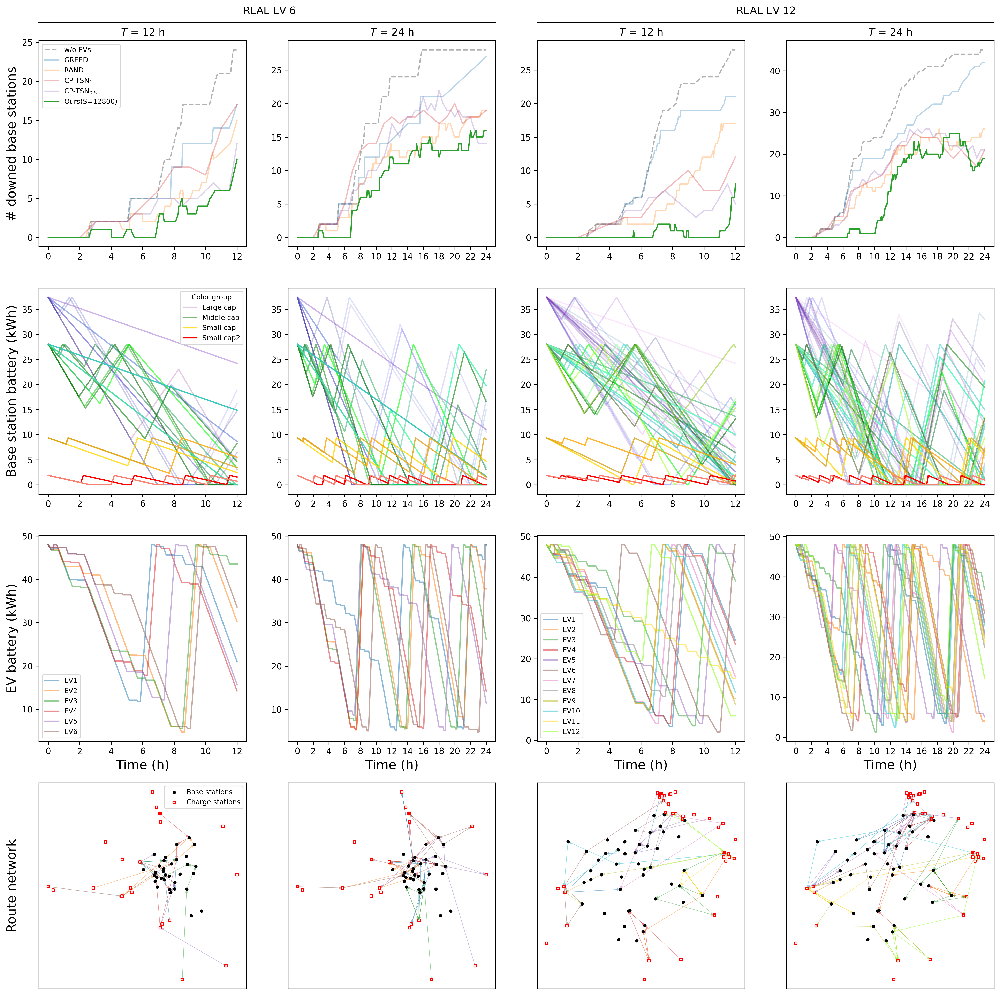

In [29]:
import pickle
from matplotlib.lines import Line2D
cmap = plt.get_cmap("tab10")

#------------------
# visual paramters
#------------------
DPI = 300
FONT_SIZE = 15
ALPHA = 0.3

vis_dataset_list = [
    ("REAL-EV6",  "data/real_datasets/real_ev6.pkl",   "checkpoints/weight100_ev6_n50_t12_drop0.2"),
    ("REAL-EV12",  "data/real_datasets/real_ev12.pkl",   "checkpoints/weight100_ev12_n50_t12_drop0.2"),
]
vis_timehorizon_list = [12, 24]
vis_model_list = [
    {
        "name": "wo_move",
        "label": "w/o EVs",
        "color": "black",
        "linestyle": "--"
    },
    {
        "name": "greedy",
        "label": "GREED",
        "color": cmap(0),
        "linestyle": "-"
    },
    {
        "name": "random",
        "label": "RAND",
        "color": cmap(1),
        "linestyle": "-"
    },
    {
        "name": "tsn1",
        "label": "CP-TSN$_1$",
        "color": cmap(3),
        "linestyle": "-"
    },
    {
        "name": "tsn05",
        "label": "CP-TSN$_{0.5}$",
        "color": cmap(4),
        "linestyle": "-"
    },
    {
        "name": "rlsample12800",
        "label": "Ours(S=12800)",
        "color": cmap(2),
        "linestyle": "-"
    },
]
output_route_model = "rlsample12800"
legend_color = {
    "red": "Small cap2", 
    "gold": "Small cap",
    "forestgreen": "Middle cap", 
    "purple": "Large cap"
}

#---------------
# visualization
#---------------
fig = plt.figure(figsize=(20, 20), dpi=DPI)
ax_dict = {}
for j, (dataset_name, dataset_path, _) in enumerate(vis_dataset_list):
    for i, time_horizon in enumerate(vis_timehorizon_list):
        prefix = f"{dataset_name}_T{time_horizon}"
        ev_batt_key    = f"{prefix}_ev_batt_hist"
        loc_batt_key   = f"{prefix}_loc_batt_hist"
        down_hist_key  = f"{prefix}_down_hist"
        route_key      = f"{prefix}_route"
        ax_dict[down_hist_key]  = fig.add_subplot(4, 4, 2*j + i + 1) # history of num. of downed base stations
        ax_dict[loc_batt_key]   = fig.add_subplot(4, 4, 2*j + i + 5) # history of Base station's battery
        ax_dict[ev_batt_key]    = fig.add_subplot(4, 4, 2*j + i + 9) # history of EV's battery
        ax_dict[route_key]      = fig.add_subplot(4, 4, 2*j + i + 13) # route

        for vis_model in vis_model_list:
            model_name = vis_model["name"]
            # load data
            res_dir = f"results/{dataset_name}_T{time_horizon}_evaluation/{model_name}/batch0-sample0"
            history_file = f"{res_dir}/history_data.pkl"

            # History of # of downed base stations
            with open(history_file, "rb") as f:
                history_data = pickle.load(f)
                alpha = 1 if model_name == output_route_model else ALPHA
                ax_dict[down_hist_key].plot(history_data["time"], history_data["down_loc"], c=vis_model["color"], label=vis_model["label"], linestyle=vis_model["linestyle"], alpha=alpha)
                ax_dict[down_hist_key].set_title(f"$T$ = {time_horizon} h")
                if i + j == 0: # The y-axis label and the legent are only present in the left-most figure.
                    ax_dict[down_hist_key].set_ylabel("# downed base stations", fontsize=FONT_SIZE)
                    ax_dict[down_hist_key].legend(fontsize=8)
                if time_horizon == 24:
                    ax_dict[down_hist_key].set_xticks(np.arange(0, 25, 2))

            if model_name == output_route_model:
                # Route visualization
                route_file = f"{res_dir}/route_info.pkl"
                with open(route_file, "rb") as f:
                    route_data = pickle.load(f)
                    visualize_route(ax_dict[route_key], route_data)
                    if i + j == 0: # The y-axis label is only present in the left-most figure.
                        ax_dict[route_key].set_ylabel("Route network", fontsize=FONT_SIZE)
                        ax_dict[route_key].legend(fontsize=8)
                        
                # Battery History
                with open(history_file, "rb") as f:
                    history_data = pickle.load(f)
                    # EV battery
                    cmap = plt.get_cmap("tab10")
                    for veh_id in range(len(history_data["veh_batt"])):
                        ax_dict[ev_batt_key].plot(history_data["time"], history_data["veh_batt"][veh_id], label=f"EV{veh_id+1}", color=get_color(veh_id), alpha=0.5)
                        ax_dict[ev_batt_key].set_xlabel("Time (h)", fontsize=FONT_SIZE)
                        if i + j == 0: # The y-axis label is only present in the left-most figure.
                            ax_dict[ev_batt_key].set_ylabel("EV battery (kWh)", fontsize=FONT_SIZE)
                            ax_dict[ev_batt_key].legend(fontsize=8)
                        if 2*j + i + 9 == 11:
                            ax_dict[ev_batt_key].legend(fontsize=8)
                        if time_horizon == 24:
                            ax_dict[ev_batt_key].set_xticks(np.arange(0, 25, 2))
                            
                    # Base station battery
                    bs_color = BSColor() 
                    for loc_id in range(len(history_data["loc_batt"])):
                        init_batt = history_data["loc_batt"][loc_id][0]
                        color, zorder, alpha = bs_color.get_color(init_batt)
                        label = None if color not in list(legend_color.keys()) else legend_color[color] 
                        ax_dict[loc_batt_key].plot(history_data["time"], history_data["loc_batt"][loc_id], alpha=alpha, color=color, zorder=zorder, label=label)
                        if i + j == 0: # The y-axis label is only present in the left-most figure.
                            ax_dict[loc_batt_key].set_ylabel("Base station battery (kWh)", fontsize=FONT_SIZE)
                            ax_dict[loc_batt_key].legend(title="Color group", title_fontsize=8, fontsize=8)
                        if time_horizon == 24:
                            ax_dict[loc_batt_key].set_xticks(np.arange(0, 25, 2))

# title setting
Y_OFFSET = 0.015
fig.text(0.312, 0.9, 'REAL-EV-6', ha='center', va='bottom', fontsize=12)
fig.text(0.715, 0.9, 'REAL-EV-12', ha='center', va='bottom', fontsize=12)
left_ax  = ax_dict["REAL-EV6_T12_down_hist"].get_position()
right_ax = ax_dict["REAL-EV6_T24_down_hist"].get_position()
fig.add_artist(Line2D([left_ax.x0, right_ax.x1], [left_ax.y1 + Y_OFFSET, left_ax.y1 + Y_OFFSET], color="black", transform=fig.transFigure, linewidth=1))
left_ax  = ax_dict["REAL-EV12_T12_down_hist"].get_position()
right_ax = ax_dict["REAL-EV12_T24_down_hist"].get_position()
fig.add_artist(Line2D([left_ax.x0, right_ax.x1], [left_ax.y1 + Y_OFFSET, left_ax.y1 + Y_OFFSET], color="black", transform=fig.transFigure, linewidth=1))
fig.align_labels([ax for ax in ax_dict.values()])

## 6. Computational Scalability Test & Generalization Test

In [30]:
RANDOM_SEED = 0
NUM_SAMPLES = 100
GPU = 0
time_horizon_list = [12, 24, 36, 48]
num_loc_list      = [25, 50, 75, 100]
num_ev_list       = [6, 12, 18, 24]

### 6.1. Generating new evaluation datasets for scalability & generalization tests 

In [31]:
# for time horizon
!python generate_dataset.py --num_locs 25 \
                            --num_vehicles 12 \
                            --save_dir data/gen_scale_test/test_time_horizon \
                            --type eval \
                            --num_samples {NUM_SAMPLES} \
                            --random_seed {RANDOM_SEED}

# for num_locs
for num_locs in num_loc_list:
    !python generate_dataset.py --num_locs {num_locs} \
                                --num_vehicles 12 \
                                --save_dir data/gen_scale_test/test_num_nodes{num_locs} \
                                --type eval \
                                --num_samples {NUM_SAMPLES} \
                                --random_seed {RANDOM_SEED}

# for num_evs
for num_evs in num_ev_list:
    !python generate_dataset.py --num_locs 50 \
                                --num_depots {num_evs} \
                                --num_vehicles {num_evs} \
                                --save_dir data/gen_scale_test/test_num_evs{num_evs} \
                                --type eval \
                                --num_samples {NUM_SAMPLES} \
                                --random_seed {RANDOM_SEED}

  0%|                                                   | 0/100 [00:00<?, ?it/s]/workspace/app/projects/github/evrp-eps/generate_dataset.py:99: DeprecationWarning: Seeding based on hashing is deprecated
since Python 3.9 and will be removed in a subsequent version. The only 
supported seed types are: None, int, float, str, bytes, and bytearray.
  random.seed(random_seed)
100%|███████████████████████████████████████| 100/100 [00:00<00:00, 2953.71it/s]
saving a dataset to data/gen_scale_test/test_time_horizon/eval_dataset.pkl...done
  0%|                                                   | 0/100 [00:00<?, ?it/s]/workspace/app/projects/github/evrp-eps/generate_dataset.py:99: DeprecationWarning: Seeding based on hashing is deprecated
since Python 3.9 and will be removed in a subsequent version. The only 
supported seed types are: None, int, float, str, bytes, and bytearray.
  random.seed(random_seed)
100%|███████████████████████████████████████| 100/100 [00:00<00:00, 1927.42it/s]
saving a d

### 6.2. Evaluation (objective value and calculation time)

In [32]:
from typing import Union
import subprocess

def call_eval(model_dir: str,
              model_type: str,
              dataset_path: str,
              time_horizon: float,
              decode_type: Union[str, float],
              search_width: int,
              output_dir: str) -> None:
    if model_type == "cp4tsn":
        # evaluate CP4TSN
        command = f"python eval_cp4tsn.py --dataset_path {dataset_path} " \
                  f"--time_horizon {time_horizon} --clustering " \
                  f"--cluster_type kmeans --parallel --num_cpus 24 " \
                  f"--limit_type time --time_limit {search_width} " \
                  f"--dt {decode_type} --log_fname {output_dir}/log.txt"
        subprocess.run(command, shell=True)
    else:    
        # evaluate naive & RL models
        eval(time_horizon=time_horizon,
             model_type=model_type,
             decode_type=decode_type,
             search_width=search_width,
             dataset_path=dataset_path,
             model_dir=model_dir,
             output_dir=output_dir,
             gpu=GPU,
             vehicle_speed=VEHICLE_SPEED,
             wait_time=WAIT_TIME,
             max_batch_size=MAX_BATCH_SIZE,
             eval_batch_size=1)

In [33]:
# we use the weights trained on REAL-EV-6S (num_evs=6, num_locs=25, T=12)
cmap = plt.get_cmap("tab10")
eval_model_list = [
    # we do not evaluate tsn here because "IndexError: list index out of range" occurs, and that is impracticable
    # {
    #     "name": "tsn1",
    #     "label": "CP-TSN$_1$",
    #     "model_type": "cp4tsn",
    #     "decode_type": 1.0, # dt
    #     "color": cmap(3),
    #     "marker": "^",
    #     "search_width": 1800, # time limit (s)
    # },
    # {
    #     "name": "tsn05",
    #     "label": "CP-TSN$_{0.5}$",
    #     "model_type": "cp4tsn",
    #     "decode_type": 0.5, # dt
    #     "color": cmap(4),
    #     "marker": "x",
    #     "search_width": 1800, # time limit (s)
    # },
    {
        "name": "greedy",
        "label": "GREED",
        "model_type": "naive_greedy",
        "decode_type": None,
        "color": cmap(0),
        "marker": "d",
        "search_width": 1,
    },
    {
        "name": "random",
        "label": "RAND",
        "color": cmap(1),
        "marker": "p",
        "model_type": "naive_random",
        "decode_type": None,
        "search_width": 12800,
    },
    {
        "name": "rlgreedy",
        "label": "Ours (G)", 
        "model_type": "rl",
        "color": cmap(5),
        "marker": "o",
        "decode_type": "greedy",
        "search_width": 1,
    },
    {
        "name": "rlsample1280",
        "label": "Ours (S=1280)",
        "model_type": "rl",
        "color": cmap(6),
        "marker": "s",
        "decode_type": "sampling",
        "search_width": 1280,
    },
    {
        "name": "rlsample12800",
        "label": "Ours (S=12800)",
        "model_type": "rl",
        "color": cmap(2),
        "marker": "*",
        "decode_type": "sampling",
        "search_width": 12800,
    },
]

In [34]:
# for time horizon
MODEL_DIR = "checkpoints/weight100_ev12_n25_t12_drop0.2"
dataset_path = "data/gen_scale_test/test_time_horizon/eval_dataset.pkl"
for eval_model in eval_model_list:
    for time_horizon in time_horizon_list:
        print(f"T = {time_horizon}")
        output_dir = f"results/test_time_horizon/{eval_model['name']}_time_horizon{time_horizon}"
        call_eval(model_dir=MODEL_DIR,
                  dataset_path=dataset_path,
                  time_horizon=time_horizon,
                  model_type=eval_model["model_type"],
                  decode_type=eval_model["decode_type"],
                  search_width=eval_model["search_width"],
                  output_dir=output_dir)

# for num_locs
MODEL_DIR = "checkpoints/weight100_ev12_n25_t12_drop0.2"
for eval_model in eval_model_list:
    for num_locs in num_loc_list:
        print(f"num_locs = {num_locs}")
        dataset_path = f"data/gen_scale_test/test_num_nodes{num_locs}/eval_dataset.pkl"
        output_dir = f"results/test_num_locs/{eval_model['name']}_num_locs{num_locs}"
        call_eval(model_dir=MODEL_DIR,
                  dataset_path=dataset_path,
                  time_horizon=12,
                  model_type=eval_model["model_type"],
                  decode_type=eval_model["decode_type"],
                  search_width=eval_model["search_width"],
                  output_dir=output_dir)
        
# for num_evs
MODEL_DIR = "checkpoints/weight100_ev6_n50_t12_drop0.2"
for eval_model in eval_model_list:
    for num_evs in num_ev_list:
        print(f"num_evs = {num_evs}")
        dataset_path = f"data/gen_scale_test/test_num_evs{num_evs}/eval_dataset.pkl"
        output_dir = f"results/test_num_evs/{eval_model['name']}_num_evs{num_evs}"
        call_eval(model_dir=MODEL_DIR,
                  dataset_path=dataset_path,
                  time_horizon=12,
                  model_type=eval_model["model_type"],
                  decode_type=eval_model["decode_type"],
                  search_width=eval_model["search_width"],
                  output_dir=output_dir)

T = 12
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:30<00:00,  3.32it/s]


T = 24
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:47<00:00,  2.09it/s]


T = 36
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [01:08<00:00,  1.47it/s]


T = 48
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [01:26<00:00,  1.15it/s]


T = 12
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [03:50<00:00,  2.31s/it]


T = 24
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [07:12<00:00,  4.32s/it]


T = 36
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [10:30<00:00,  6.30s/it]


T = 48
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [13:38<00:00,  8.19s/it]


T = 12
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:37<00:00,  2.68it/s]


T = 24
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [01:15<00:00,  1.33it/s]


T = 36
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [01:43<00:00,  1.03s/it]


T = 48
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [02:15<00:00,  1.35s/it]


T = 12
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [02:33<00:00,  1.54s/it]


T = 24
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [05:50<00:00,  3.51s/it]


T = 36
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [08:24<00:00,  5.04s/it]


T = 48
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [11:10<00:00,  6.70s/it]


T = 12
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [11:49<00:00,  7.09s/it]


T = 24
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [25:15<00:00, 15.16s/it]


T = 36
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [36:07<00:00, 21.67s/it]


T = 48
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [47:19<00:00, 28.40s/it]


num_locs = 25
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:29<00:00,  3.40it/s]


num_locs = 50
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:30<00:00,  3.27it/s]


num_locs = 75
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:30<00:00,  3.30it/s]


num_locs = 100
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:30<00:00,  3.24it/s]


num_locs = 25
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [03:50<00:00,  2.30s/it]


num_locs = 50
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [02:54<00:00,  1.74s/it]


num_locs = 75
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [02:59<00:00,  1.79s/it]


num_locs = 100
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [03:05<00:00,  1.86s/it]


num_locs = 25
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:38<00:00,  2.63it/s]


num_locs = 50
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:34<00:00,  2.92it/s]


num_locs = 75
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:38<00:00,  2.61it/s]


num_locs = 100
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:41<00:00,  2.43it/s]


num_locs = 25
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [02:34<00:00,  1.55s/it]


num_locs = 50
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [02:41<00:00,  1.61s/it]


num_locs = 75
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [03:44<00:00,  2.25s/it]


num_locs = 100
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [04:21<00:00,  2.62s/it]


num_locs = 25
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [11:48<00:00,  7.09s/it]


num_locs = 50
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [13:49<00:00,  8.30s/it]


num_locs = 75
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [22:35<00:00, 13.56s/it]


num_locs = 100
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [28:06<00:00, 16.87s/it]


num_evs = 6
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:16<00:00,  6.02it/s]


num_evs = 12
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:30<00:00,  3.25it/s]


num_evs = 18
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:45<00:00,  2.19it/s]


num_evs = 24
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [00:59<00:00,  1.68it/s]


num_evs = 6
selected device: GPU #0


100%|█████████████████████████████████████████████████████████████████████████████████| 100/100 [01:06<00:00,  1.50it/s]


num_evs = 12
selected device: GPU #0


 98%|████████████████████████████████████████████████████████████████████████████████▎ | 98/100 [02:50<00:03,  1.74s/it]IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



### 6.3. Plotting thr results of scalability & generalization tests

In [35]:
import matplotlib
import matplotlib.pyplot as plt
markersize = 8
capsize = 5

def plot_scale_gen_res(model_list,
                       ax_dict: Dict[str, matplotlib.axes.Axes],
                       lst: List[int],
                       get_log_fname,
                       xlabel: str = None,
                       ylabel_scale: str = None,
                       ylabel_gen: str = None) -> dict:
    res = {"obj": {}, "time": {}, "obj_std": {}, "time_std": {}}
    for id, model in enumerate(model_list):
        model_name = model["name"]
        res["obj"][model_name] = []
        res["time"][model_name] = []
        res["obj_std"][model_name] = []
        res["time_std"][model_name] = []
        for elem in lst:
            log_fname = get_log_fname(model_name, elem)
            with open(log_fname, "r") as f:
                res_ = json.load(f)
            res["obj"][model_name].append(float(res_["avg_obj"]))        # objevtive value
            res["time"][model_name].append(float(res_["avg_calc_time"])) # averaged calc time per one sample
            res["obj_std"][model_name].append(float(res_["std_obj"]))        # std of objevtive values
            res["time_std"][model_name].append(float(res_["std_calc_time"])) # std of averaged calc time per one sample
    
        def vis_graph(ax_dict_: Dict[str, matplotlib.axes.Axes],
                      key: str,
                      xlabel: str = None,
                      ylabel: str = None) -> None:
            # ax_timehorizon[key].errorbar(time_horizon_list,
            #                              timehorizon_res[key][model_name],
            #                              timehorizon_res[f"{key}_std"][model_name],
            #                              label=label,
            #                              marker=marker,
            #                              markersize=markersize,
            #                              capsize=capsize)
            x = np.array(lst)
            y = np.array(res[key][model_name])
            std = np.array(res[f"{key}_std"][model_name])
            ax_dict_[key].plot(x,
                               y,
                               label=model["label"],
                               marker=model["marker"],
                               markersize=markersize,
                               color=model["color"])
            ax_dict_[key].fill_between(lst, y-std, y+std, alpha=0.2, color=model["color"])
            if key == "time":
                # aux. line
                ax_dict_[key].plot(x, (y[0]/x[0])*x, linestyle="--", color=model["color"], alpha=0.5)
            if xlabel is not None:
                ax_dict_[key].set_xlabel(xlabel, fontsize=20)
            if ylabel is not None:
                ax_dict_[key].set_ylabel(ylabel, fontsize=20)
            ax_dict_[key].set_xticks(lst)
            ax_dict_[key].xaxis.set_tick_params(labelsize=18)
            ax_dict_[key].yaxis.set_tick_params(labelsize=18)
    
        # scalability
        if model_name in ["rlgreedy", "rlsample1280", "rlsample12800"]:
            vis_graph(ax_dict, "time", ylabel=ylabel_scale)
        # generalization
        if model_name in ["greedy", "random", "rlsample12800"]:
            vis_graph(ax_dict, "obj", xlabel, ylabel_gen)
    return res

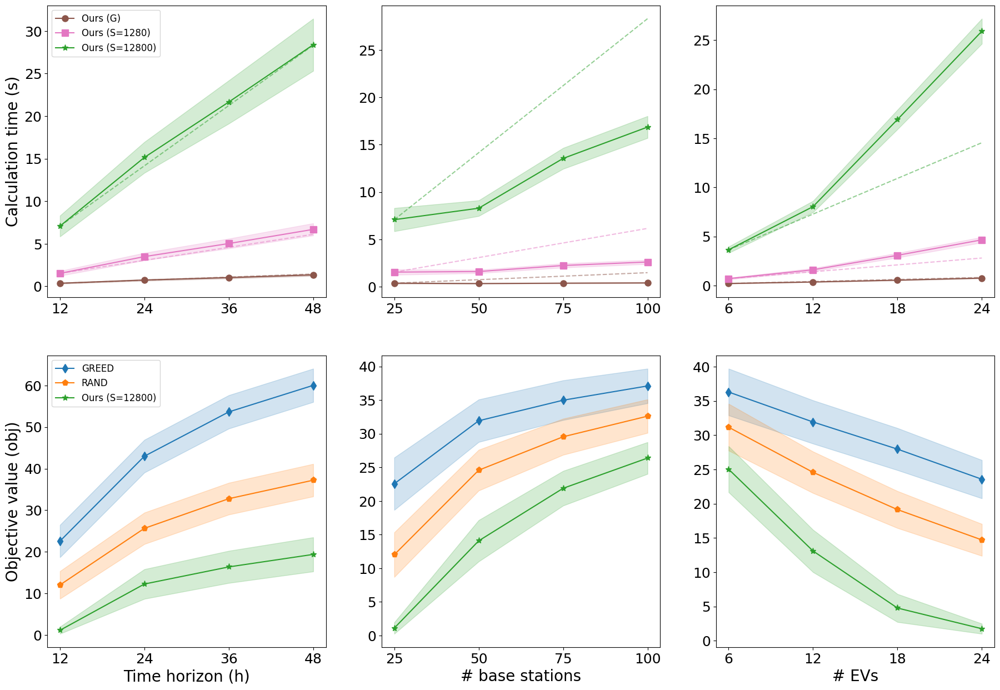

In [36]:
fig = plt.figure(figsize=(22, 15))
ax_timehorizon = {"time": fig.add_subplot(2, 3, 1), "obj": fig.add_subplot(2, 3, 4)}
ax_nlocs       = {"time": fig.add_subplot(2, 3, 2), "obj": fig.add_subplot(2, 3, 5)}
ax_nevs        = {"time": fig.add_subplot(2, 3, 3), "obj": fig.add_subplot(2, 3, 6)}

#------------------
# for time horizon
#------------------
def get_time_horizon_fname(model_name, time_horizon_):
    return f"results/test_time_horizon/{model_name}_time_horizon{time_horizon_}" + "/summary.json"
timehorizon_res = plot_scale_gen_res(eval_model_list, ax_timehorizon, time_horizon_list, get_time_horizon_fname, xlabel="Time horizon (h)", ylabel_scale="Calculation time (s)", ylabel_gen="Objective value (obj)")
ax_timehorizon["time"].legend(fontsize=12)
ax_timehorizon["obj"].legend(fontsize=12)

#---------------
# for num nodes
#---------------
def get_nlocs_fname(model_name, num_locs_):
    return f"results/test_num_locs/{model_name}_num_locs{num_locs_}" + "/summary.json"
nlocs_res = plot_scale_gen_res(eval_model_list, ax_nlocs, num_loc_list, get_nlocs_fname, xlabel="# base stations")

#-------------
# for num evs
#-------------
def get_nevs_fname(model_name, num_evs_):
    return f"results/test_num_evs/{model_name}_num_evs{num_evs_}" + "/summary.json"
nevs_res = plot_scale_gen_res(eval_model_list, ax_nevs, num_ev_list, get_nevs_fname, xlabel="# EVs")